# Annotations using clustering for cells for bone_s0

In [1]:
slide_id = "bone_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_bone_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 36158, 34751), (3, 18079, 17376)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (33801, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (33801, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (33801, 477)
      └── 'table_nuclei': AnnData (33801, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 33801 × 477
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,9,0,0,0,0,9,769.959247,42.808127,cell_labels
1,aaaaaaab-1,15,0,0,0,0,15,748.148777,15.082188,cell_labels
2,aaaaaaac-1,3,0,0,0,0,3,791.814872,15.849844,cell_labels
3,aaaaaaad-1,78,0,0,0,0,78,781.203153,16.436876,cell_labels
4,aaaaaaae-1,9,0,0,0,0,9,431.016422,8.579688,cell_labels
...,...,...,...,...,...,...,...,...,...,...
33796,aaaaieae-1,42,0,0,0,0,42,665.377368,29.441876,cell_labels
33797,aaaaieaf-1,8,0,0,0,0,8,346.122669,13.140469,cell_labels
33798,aaaaieag-1,48,0,0,0,0,48,818.953780,7.270157,cell_labels
33799,aaaaieah-1,15,0,0,0,0,15,787.434716,33.235001,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACAN,ENSG00000157766,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
...,...,...,...
VPREB3,ENSG00000128218,Gene Expression,Unknown
VSIG4,ENSG00000155659,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown
VWF,ENSG00000110799,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 5365 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,14.247191,Effector/Memory CD4 T cell,11,1,1,4,4,Osteoblast,Osteoblast,normal_cell
aaaaaaba-1,nucleus_boundaries,morpho,aaaaaaba-1,30.344586,S100A+ preNeutrophil (cycling),19,1,1,3,3,Osteoblast,Osteoblast,normal_cell
aaaaaabh-1,nucleus_boundaries,morpho,aaaaaabh-1,32.060425,Naive B cell,50,3,4,5,5,B,B,normal_cell
aaaaaabm-1,nucleus_boundaries,morpho,aaaaaabm-1,32.624612,Naive B cell,55,3,4,5,5,B,B,normal_cell
aaaaaabn-1,nucleus_boundaries,morpho,aaaaaabn-1,41.002156,preB cell,57,3,4,5,5,B,B,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaaidkd-1,nucleus_boundaries,morpho,aaaaidkd-1,42.196150,CD14+MHCIIlow monocyte,52,3,4,5,5,B,B,normal_cell
aaaaidkj-1,nucleus_boundaries,morpho,aaaaidkj-1,26.285835,CD16+ NK,11,0,0,0,0,Unknown,Unknown,normal_cell
aaaaidln-1,nucleus_boundaries,morpho,aaaaidln-1,15.261962,CD14+MHCIIlow monocyte,14,0,0,0,0,Unknown,Unknown,normal_cell
aaaaidmc-1,nucleus_boundaries,morpho,aaaaidmc-1,44.587439,preB cell,31,0,0,0,0,Unknown,Unknown,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.024849,0.389079
ACAN,0.094950,0.751787
ACE2,0.059053,0.599131
ACKR1,0.060344,0.612176
ACTA2,0.205959,1.120607
...,...,...
VPREB3,0.008401,0.218818
VSIG4,0.106308,0.808273
VWA5A,0.179073,1.046216
VWF,0.767141,2.103747


## 2. Preprocessing

<Axes: >

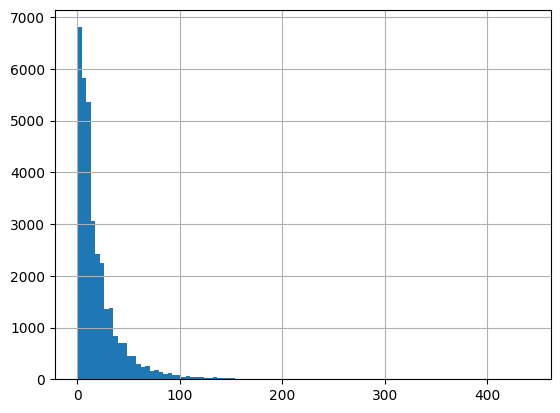

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

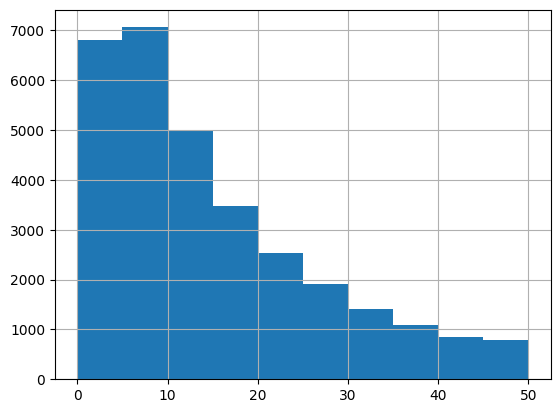

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 22337
Percentage of cells with less than 20 transcripts: 66.08%
-----
Number of cells with less than 15 transcripts: 18861
Percentage of cells with less than 15 transcripts: 55.8%
-----
Number of cells with less than 10 transcripts: 13862
Percentage of cells with less than 10 transcripts: 41.01%
-----
Number total of cells: 33801


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

18799


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


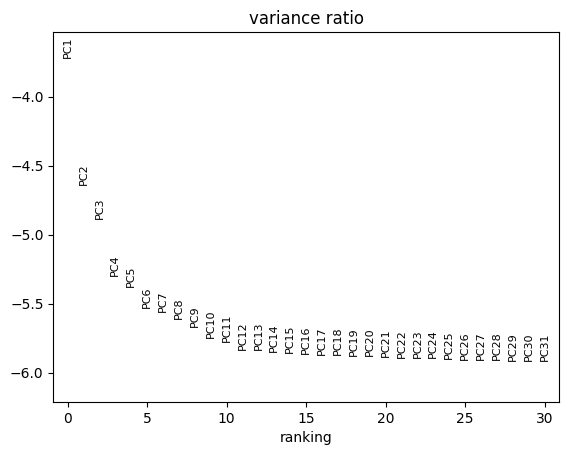

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 18799 × 477
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=12, use_rep="X_pca", key_added='pca_n10_pcs12')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs12')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs12_leiden_res0.2', neighbors_key='pca_n10_pcs12')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs12_leiden_res0.4', neighbors_key='pca_n10_pcs12')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs12_leiden_res0.6', neighbors_key='pca_n10_pcs12')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_5756/1107859218.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs12_leiden_res0.2', neighbors_key='pca_n10_pcs12')


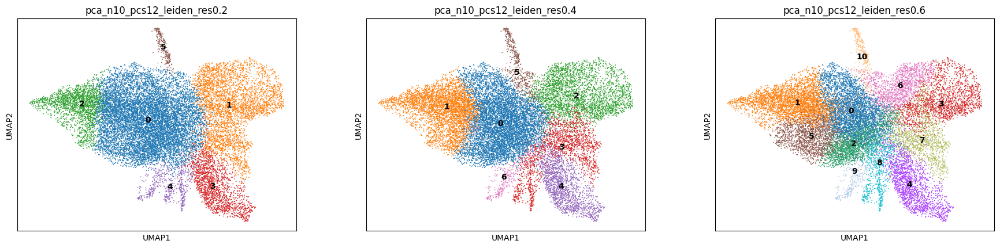

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs12',
           color=['pca_n10_pcs12_leiden_res0.2', 'pca_n10_pcs12_leiden_res0.4', 'pca_n10_pcs12_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].unique()

['6', '3', '10', '1', '4', ..., '2', '0', '8', '5', '9']
Length: 11
Categories (11, object): ['0', '1', '2', '3', ..., '7', '8', '9', '10']

In [24]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs12_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'

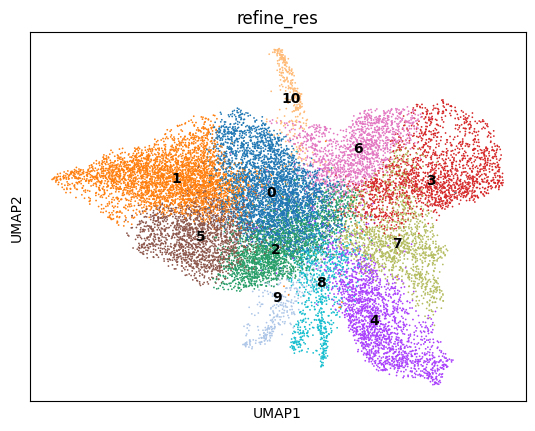

In [25]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs12', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [26]:
clustering_label = 'refine_res'

In [27]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

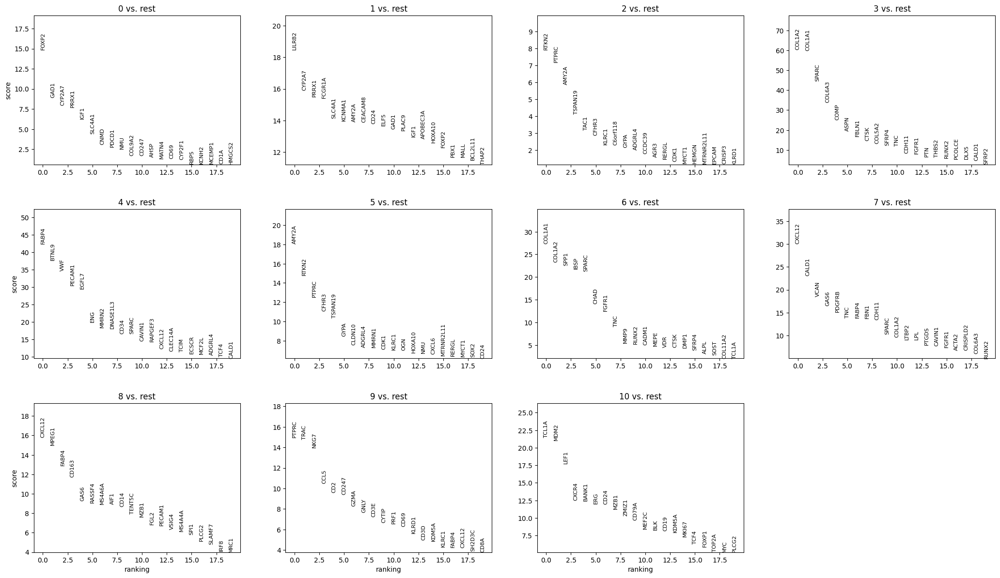

In [28]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [31]:
cluster_id = '0'

In [32]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,93.5
1,Unknown,Unknown,normal_cell,5.7
2,Osteoblast,Osteoblast,normal_cell,0.4
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,0.1
4,B,B,normal_cell,0.1


In [33]:
top_ranked_genes[cluster_id]

0     FOXP2
1      GAD1
2    CYP2A7
3     PRRX1
4      IGF1
5    SLC4A1
6      CNMD
Name: 0, dtype: object

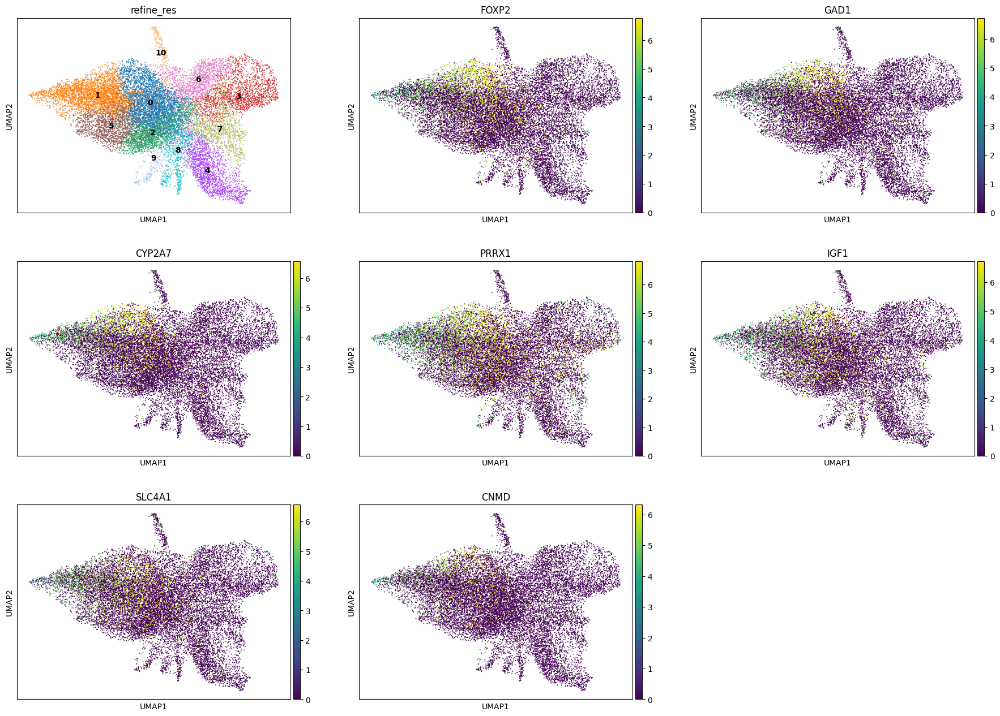

In [34]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 3551
Percentage of cells in cluster 0: 18.9


In [36]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Osteoblast/Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Osteoblast/Unknown'

### 5.2. Cluster 1

In [37]:
cluster_id = '1'

In [38]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,81.6
1,Unknown,Unknown,normal_cell,14.7
2,Osteoblast,Osteoblast,normal_cell,1.7
3,B,B,normal_cell,0.6
4,Endothelial,Endothelial,normal_cell,0.5


In [39]:
top_ranked_genes[cluster_id]

0    LILRB2
1    CYP2A7
2     PRRX1
3    FCGR1A
4    SLC4A1
5    KCNMA1
6     AMY2A
Name: 1, dtype: object

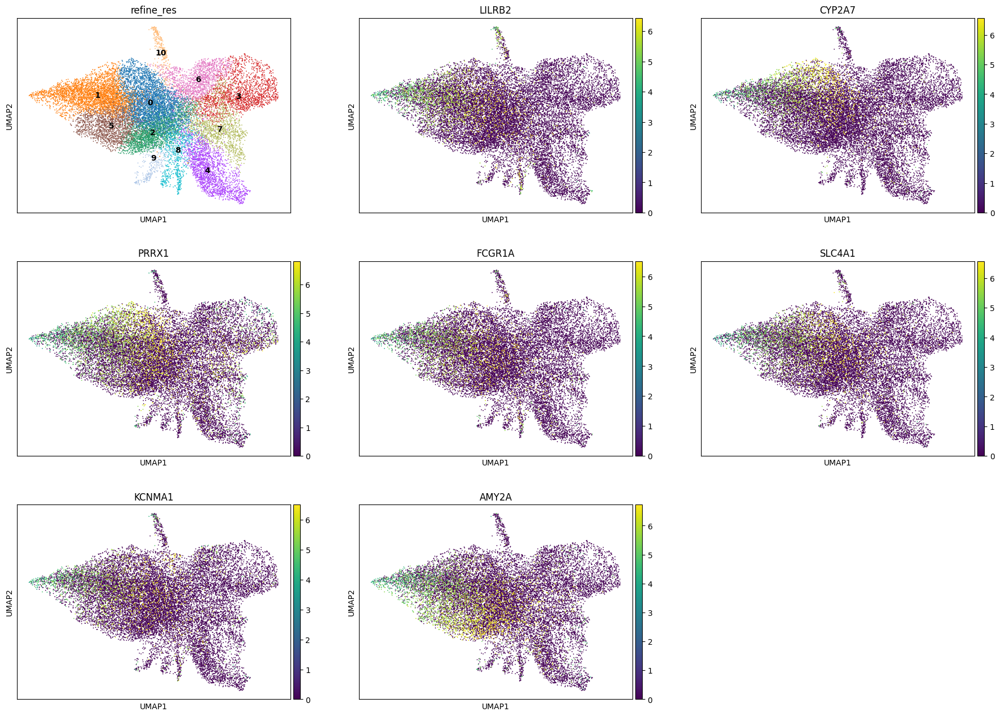

In [40]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 3514
Percentage of cells in cluster 1: 18.7


In [42]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Osteoblast/Unknown/Myeloid'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Osteoblast/Unknown/Myeloid'

### 5.3. Cluster 2

In [43]:
cluster_id = '2'

In [44]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,81.5
1,Unknown,Unknown,normal_cell,17.3
2,Fibroblast,Fibroblast,normal_cell,0.7
3,Mast,Mast,normal_cell,0.3
4,Osteoblast,Osteoblast,normal_cell,0.1


In [45]:
top_ranked_genes[cluster_id]

0      RTKN2
1      PTPRC
2      AMY2A
3    TSPAN19
4       TAC1
5      CFHR3
6      KLRC1
Name: 2, dtype: object

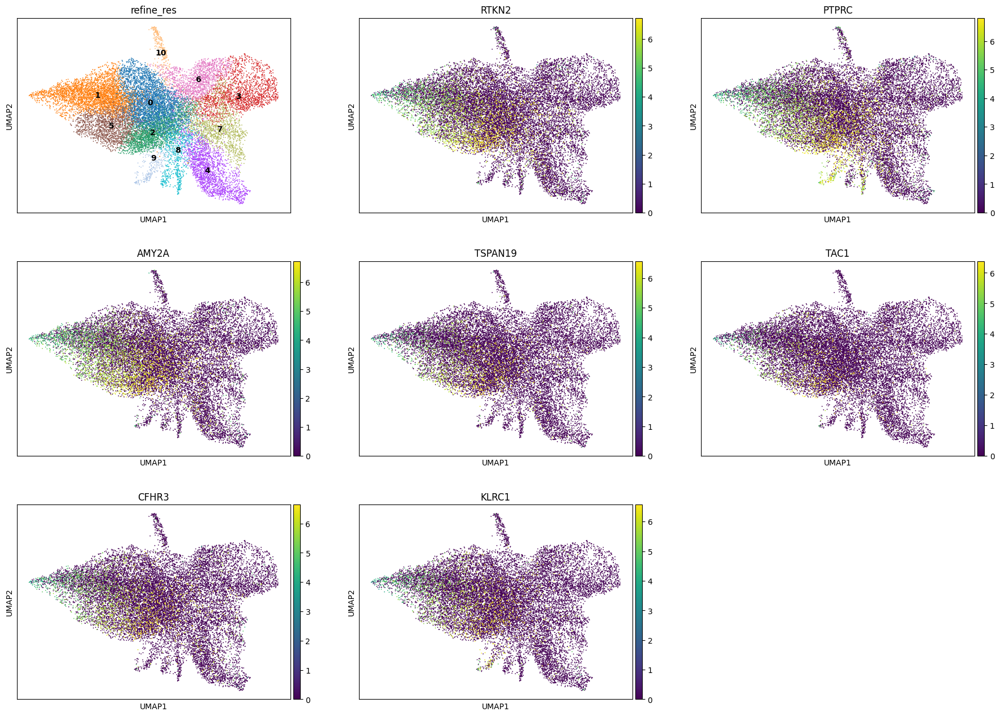

In [46]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [47]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 1979
Percentage of cells in cluster 2: 10.5


In [48]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Unknwown'

### 5.4. Cluster 3

In [49]:
cluster_id = '3'

In [50]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,65.6
1,Osteoblast,Osteoblast,normal_cell,30.1
2,Fibroblast,Fibroblast,normal_cell,3.7
3,Osteoclast,Osteoclast,normal_cell,0.3
4,Endothelial,Endothelial,normal_cell,0.2


In [51]:
top_ranked_genes[cluster_id]

0    COL1A2
1    COL1A1
2     SPARC
3    COL6A3
4      COMP
5      ASPN
6     FBLN1
Name: 3, dtype: object

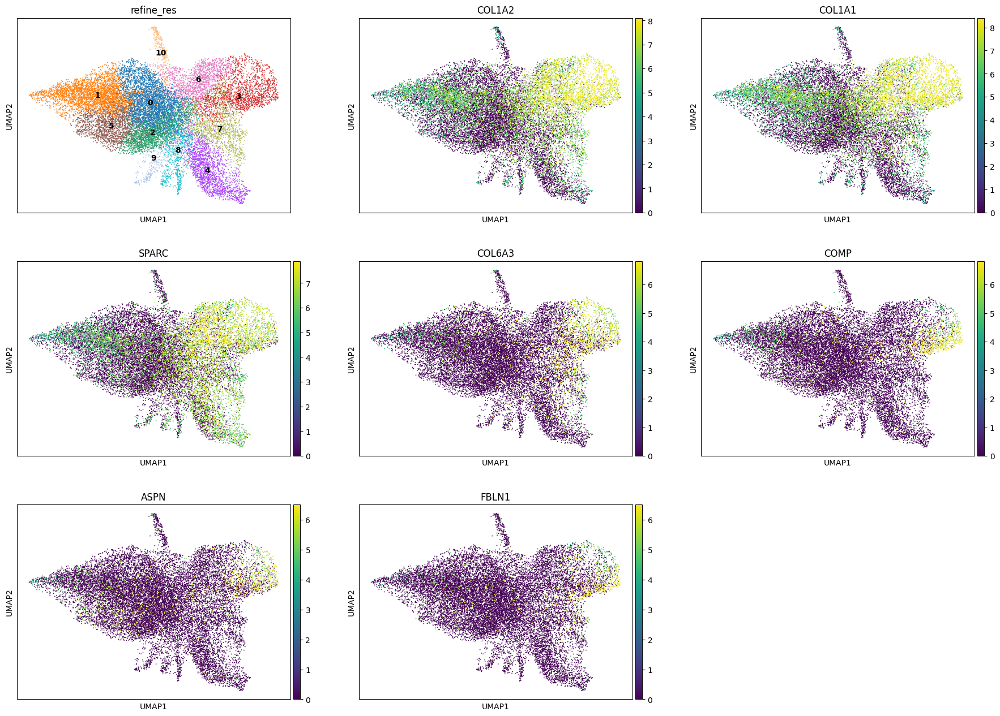

In [52]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [53]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 1884
Percentage of cells in cluster 3: 10.0


In [54]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Osteoblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Osteoblast'

### 5.5. Cluster 4

In [55]:
cluster_id = '4'

In [56]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,53.9
1,Endothelial,Endothelial,normal_cell,43.3
2,Fibroblast,Fibroblast,normal_cell,1.5
3,Unknown,Unknown,normal_cell,0.5
4,Osteoblast,Osteoblast,normal_cell,0.3


In [57]:
top_ranked_genes[cluster_id]

0     FABP4
1     BTNL9
2       VWF
3    PECAM1
4     EGFL7
5       ENG
6     MMRN2
Name: 4, dtype: object

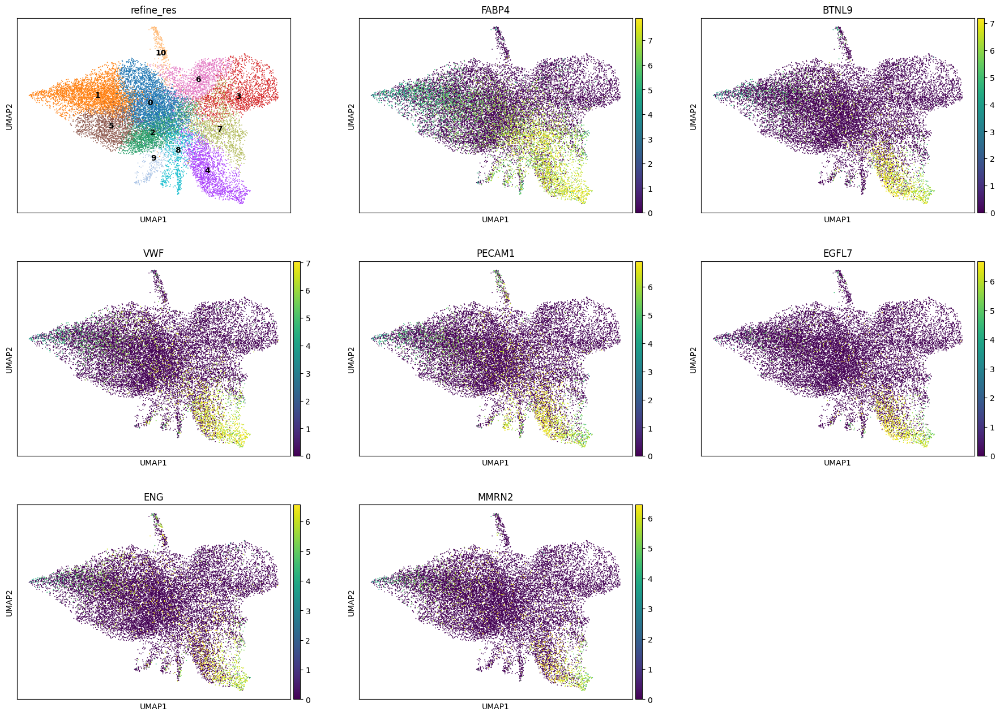

In [58]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 1877
Percentage of cells in cluster 4: 10.0


In [60]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.6. Cluster 5

In [61]:
cluster_id = '5'

In [62]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,53.5
1,Unknown,Unknown,normal_cell,44.6
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,0.5
3,T/NK,T/NK,normal_cell,0.4
4,Osteoblast,Osteoblast,normal_cell,0.3


In [63]:
top_ranked_genes[cluster_id]

0      AMY2A
1      RTKN2
2      PTPRC
3      CFHR3
4    TSPAN19
5       GYPA
6     CLDN10
Name: 5, dtype: object

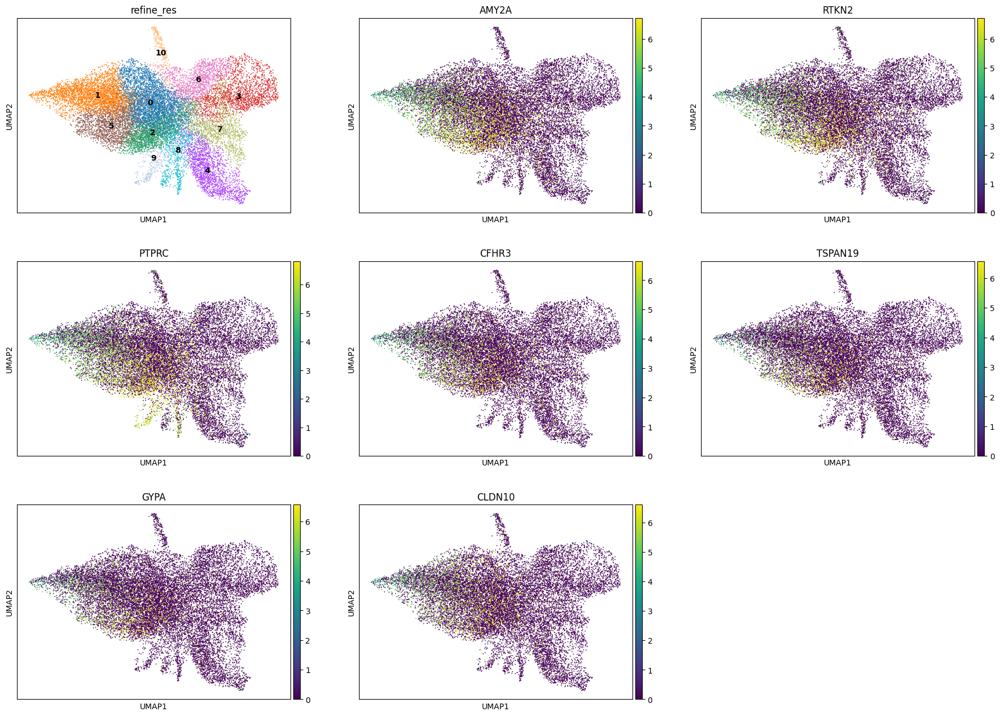

In [64]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 1669
Percentage of cells in cluster 5: 8.9


In [66]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.7. Cluster 6

In [67]:
cluster_id = '6'

In [68]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,69.6
1,Osteoblast,Osteoblast,normal_cell,24.0
2,Fibroblast,Fibroblast,normal_cell,3.3
3,Osteoclast,Osteoclast,normal_cell,1.4
4,Unknown,Unknown,normal_cell,1.0


In [69]:
top_ranked_genes[cluster_id]

0    COL1A1
1    COL1A2
2      SPP1
3      IBSP
4     SPARC
5      CHAD
6     FGFR1
Name: 6, dtype: object

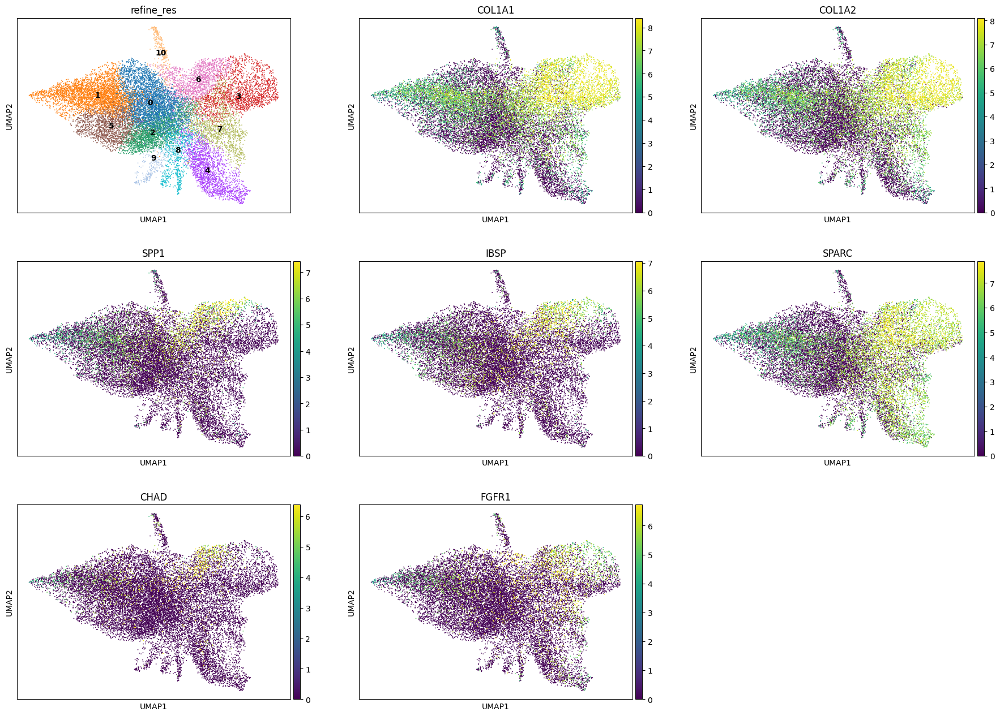

In [70]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 1409
Percentage of cells in cluster 6: 7.5


In [72]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Osteoblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Osteoblast'

### 5.8. Cluster 7

In [73]:
cluster_id = '7'

In [74]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,52.8
1,Fibroblast,Fibroblast,normal_cell,39.0
2,Adipocyte,Adipocyte,normal_cell,2.5
3,Osteoblast,Osteoblast,normal_cell,2.0
4,Endothelial,Endothelial,normal_cell,1.5


In [75]:
top_ranked_genes[cluster_id]

0    CXCL12
1     CALD1
2      VCAN
3      GAS6
4    PDGFRB
5       TNC
6     FABP4
Name: 7, dtype: object

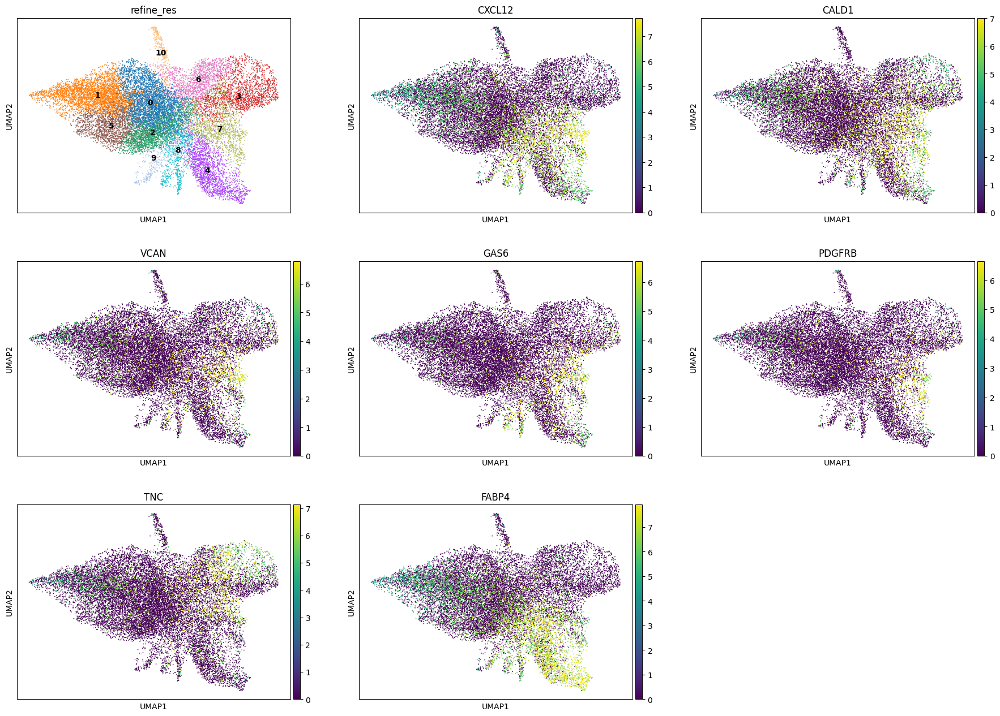

In [76]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 1380
Percentage of cells in cluster 7: 7.3


In [78]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mesenchymal_stromal_cell'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'MSC'

### 5.9. Cluster 8

In [79]:
cluster_id = '8'

In [80]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,62.2
1,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,21.4
2,Plasma,Plasma,normal_cell,8.3
3,Unknown,Unknown,normal_cell,3.6
4,Fibroblast,Fibroblast,normal_cell,2.1


In [81]:
top_ranked_genes[cluster_id]

0    CXCL12
1     MPEG1
2     FABP4
3     CD163
4      GAS6
5    RASSF4
6    MS4A6A
Name: 8, dtype: object

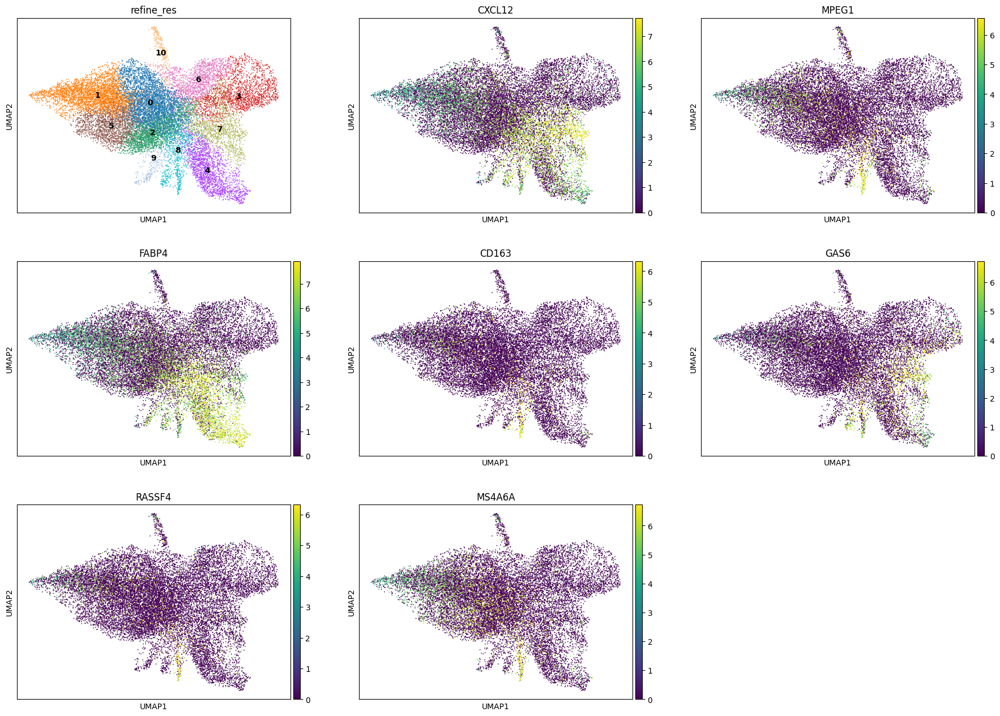

In [82]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 796
Percentage of cells in cluster 8: 4.2


In [84]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.10. Cluster 9

In [85]:
cluster_id = '9'

In [86]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,57.0
1,T/NK,T/NK,normal_cell,38.0
2,Unknown,Unknown,normal_cell,3.0
3,Fibroblast,Fibroblast,normal_cell,0.8
4,Plasma,Plasma,normal_cell,0.5


In [87]:
top_ranked_genes[cluster_id]

0    PTPRC
1     TRAC
2     NKG7
3     CCL5
4      CD2
5    CD247
6     GZMA
Name: 9, dtype: object

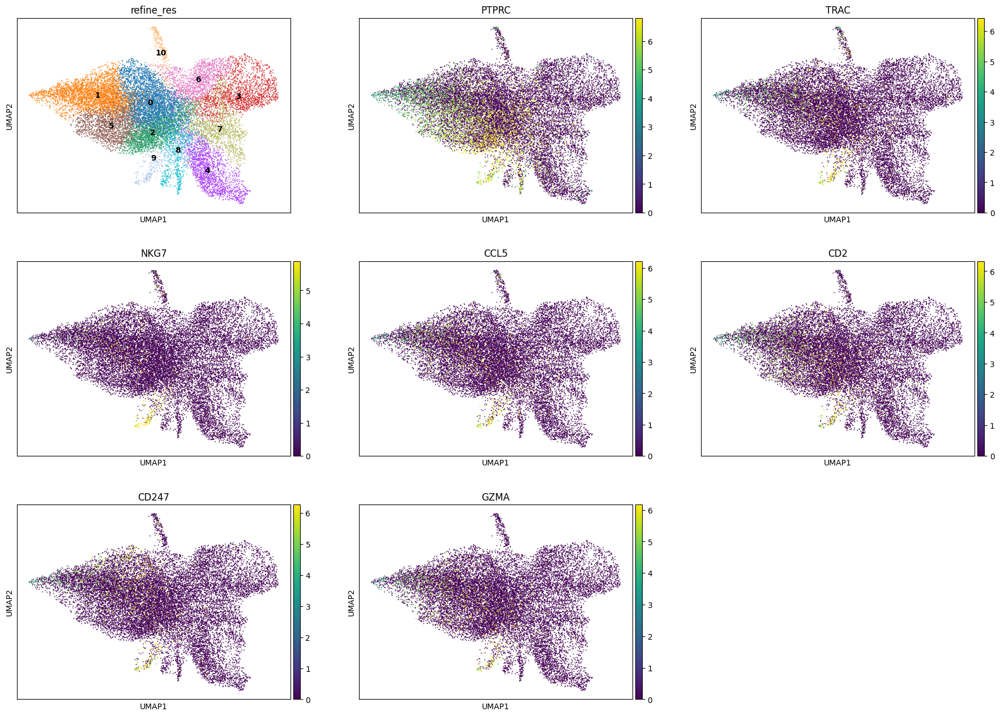

In [88]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [89]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 395
Percentage of cells in cluster 9: 2.1


In [91]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T/NK'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T/NK'

### 5.11. Cluster 10

In [92]:
cluster_id = '10'

In [93]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,60.6
1,NA,NA,NA,35.9
2,Unknown,Unknown,normal_cell,1.7
3,Endothelial,Endothelial,normal_cell,0.6
4,Adipocyte,Adipocyte,normal_cell,0.3


In [94]:
top_ranked_genes[cluster_id]

0    TCL1A
1     MDM2
2     LEF1
3    CXCR4
4    BANK1
5      ERG
6     CD24
Name: 10, dtype: object

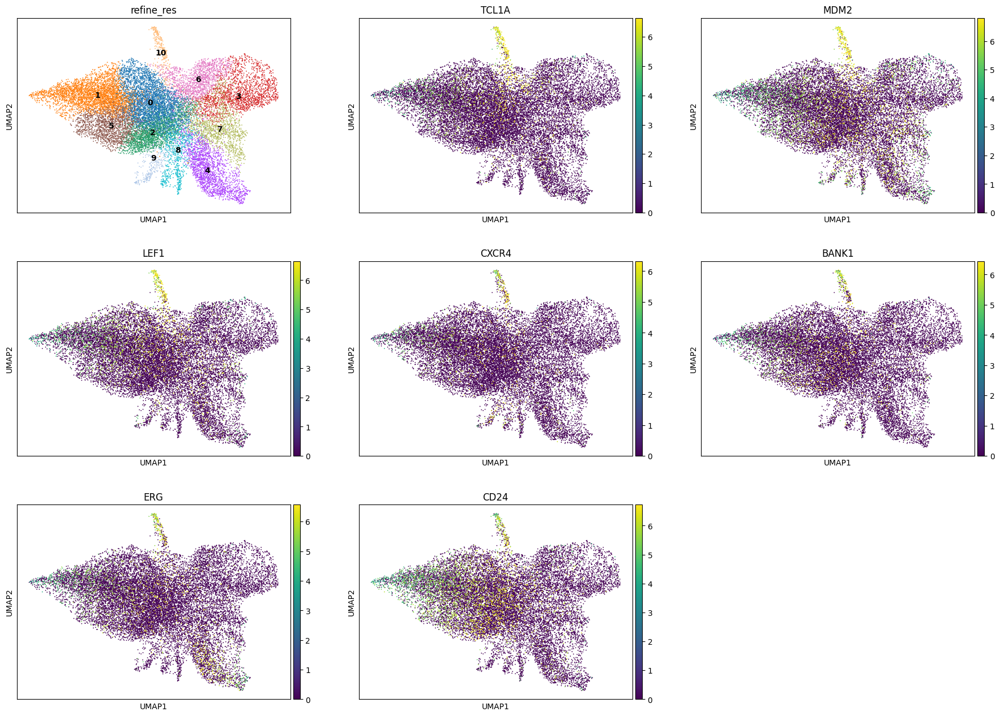

In [95]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [96]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 345
Percentage of cells in cluster 10: 1.8


In [97]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

## 6. Cancer cells

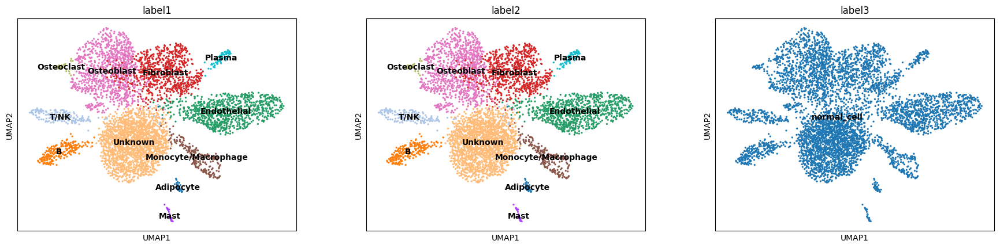

In [100]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

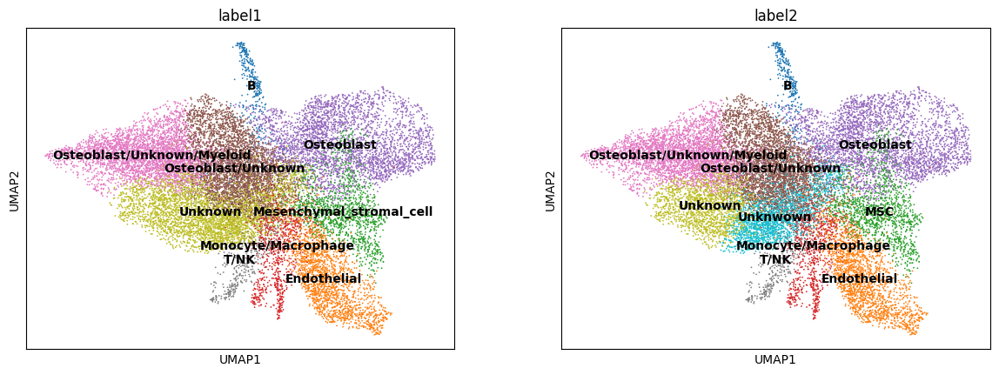

In [101]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [102]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'

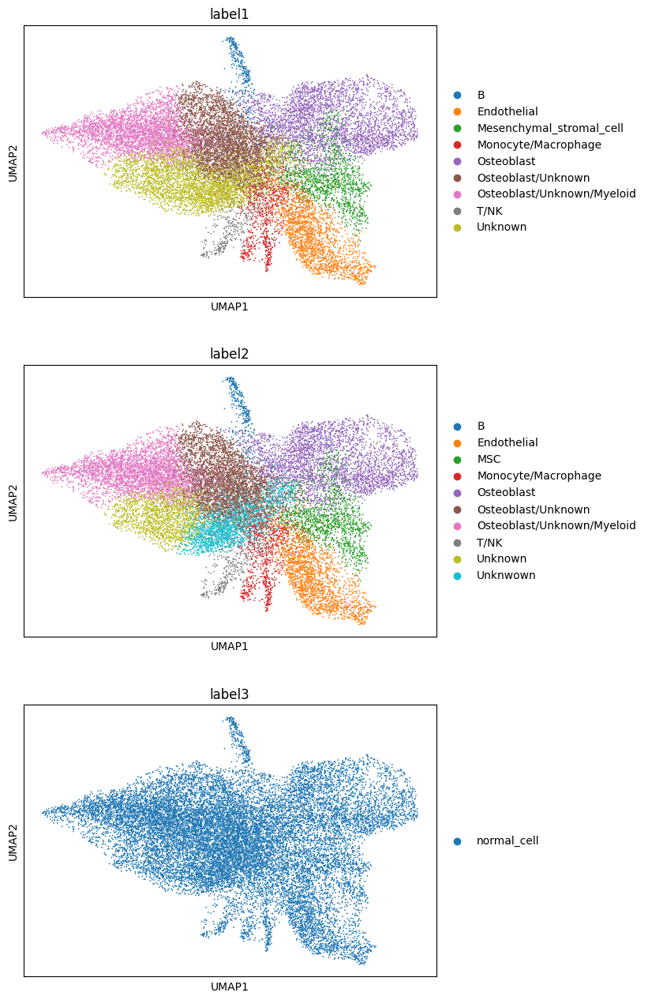

In [103]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [104]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs12_leiden_res0.2,pca_n10_pcs12_leiden_res0.4,pca_n10_pcs12_leiden_res0.6,refine_res,label1,label2,label3
1,aaaaaaab-1,15,0,0,0,0,15,748.148777,15.082188,cell_labels,0,5,6,6,Osteoblast,Osteoblast,normal_cell
3,aaaaaaad-1,78,0,0,0,0,78,781.203153,16.436876,cell_labels,1,2,3,3,Osteoblast,Osteoblast,normal_cell
12,aaaaaaam-1,14,0,0,0,0,14,989.779880,22.894220,cell_labels,0,5,6,6,Osteoblast,Osteoblast,normal_cell
14,aaaaaaao-1,16,0,0,0,0,16,363.417513,14.630626,cell_labels,1,2,6,6,Osteoblast,Osteoblast,normal_cell
16,aaaaaaba-1,32,0,0,0,0,32,751.490340,34.770314,cell_labels,1,2,6,6,Osteoblast,Osteoblast,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33795,aaaaiead-1,16,0,0,0,0,16,444.698766,7.179844,cell_labels,0,0,0,0,Osteoblast/Unknown,Osteoblast/Unknown,normal_cell
33796,aaaaieae-1,42,0,0,0,0,42,665.377368,29.441876,cell_labels,0,1,1,1,Osteoblast/Unknown/Myeloid,Osteoblast/Unknown/Myeloid,normal_cell
33798,aaaaieag-1,48,0,0,0,0,48,818.953780,7.270157,cell_labels,0,1,1,1,Osteoblast/Unknown/Myeloid,Osteoblast/Unknown/Myeloid,normal_cell
33799,aaaaieah-1,15,0,0,0,0,15,787.434716,33.235001,cell_labels,0,2,6,6,Osteoblast,Osteoblast,normal_cell


In [105]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")